# **Experiment on Clustering Model on using Transaction and Customer Dataset**





## Context
This project analyzes transaction and customer datasets to identify groups and their spending behaviors. By understanding these patterns, the marketing team can create customized email campaigns, enhancing engagement and increasing the effectiveness of targeted promotions. This approach aims to improve customer satisfaction and drive sales growth.


### 0. Import Packages

In [1]:
! pip install -r https://raw.githubusercontent.com/aso-uts/labs_datasets/main/36106-mlaa/requirements.txt

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 12.3/12.3 MB 75.0 MB/s eta 0:00:00
  Attempting uninstall: pandas
    Found existing installation: pandas 2.0.3
    Uninstalling pandas-2.0.3:
      Successfully uninstalled pandas-2.0.3
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
google-colab 1.0.0 requires pandas==2.0.3, but you have pandas 2.1.1 which is incompatible.


In [2]:
import zipfile
import os
import gdown
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.cluster import KMeans, MeanShift, AgglomerativeClustering
import warnings
from sklearn.preprocessing import StandardScaler
from wordcloud import WordCloud
from sklearn.metrics import silhouette_score
from scipy.cluster.hierarchy import dendrogram
from sklearn.decomposition import PCA

In [3]:
warnings.filterwarnings("ignore")

### 1.   Load Dataset

In [4]:
# Extract ZIP file
def extract_file(zip_path, extract_to):
  if os.path.exists(zip_path):
    try:
      with zipfile.ZipFile(zip_path, 'r') as zip_ref:
        zip_ref.extractall(extract_to) # extract zip file
      print("Extraction was successful")
      os.remove(zip_path) # remove zip file
    except zipfile.BadZipFile:
      print("Failed to extract: the downloaded file is not a ZIP file or is corrupt")
  else:
    print("File does not exist, check the download URL and process.")

In [5]:
# Link to dataset
url = 'https://drive.google.com/uc?id=1ipwbg0VClq9OGYP-B9wnFegKxPneMFug'
output_zip = '/content/bank_transaction.zip'

# Download the ZIP file
gdown.download(url, output_zip, quiet=False)

# Directory to extract the ZIP contents
extraction_directory = '/content/datasets/'

# Attempt to extract the ZIP file
extract_file(output_zip, extraction_directory)

Downloading...
From (original): https://drive.google.com/uc?id=1ipwbg0VClq9OGYP-B9wnFegKxPneMFug
From (redirected): https://drive.google.com/uc?id=1ipwbg0VClq9OGYP-B9wnFegKxPneMFug&confirm=t&uuid=fc5a4e5d-4514-423b-80b9-43deb8079b6c
To: /content/bank_transaction.zip
100%|██████████| 215M/215M [00:01<00:00, 153MB/s]


Extraction was successful


In [6]:
# merging all the transaction files
csv_files = [f for f in os.listdir(f'{extraction_directory}final') if f.startswith('transactions_') and f.endswith('.csv')]
dataframes = [pd.read_csv(os.path.join(f'{extraction_directory}final', f), delimiter='|') for f in csv_files]
transactions_df = pd.concat(dataframes, ignore_index=True)
transactions_df.head()

,cc_num,acct_num,trans_num,unix_time,category,amt,is_fraud,merchant,merch_lat,merch_long
0,377480957394058,256845189467,5c010d5684d75b59d6aa02d81a3613c1,1583184159,misc_net,80.46,0,Marshall LLC,41.919802,-87.592037
1,377480957394058,256845189467,beeac075680cfebb3ecfb6894a3a9a90,1555701663,gas_transport,58.58,0,Phelps-Campbell,41.032331,-88.592018
2,377480957394058,256845189467,960dbd5058152c1c08994fd12a992d00,1575072903,grocery_pos,60.11,0,"Hopkins, Jordan and Blair",41.865136,-88.818713
3,377480957394058,256845189467,d7678c49fefe6fc8b4120e8c2ec99540,1575297118,grocery_pos,36.41,0,"Williams, Bray and Aguilar",41.984380,-87.540684
4,377480957394058,256845189467,32d071025482e41ddc1963a6445ac61d,1563209257,grocery_net,60.17,0,Fitzgerald Group,42.206876,-87.130330


In [7]:
transactions_df.shape

(4260904, 10)

As we can see that there are more than 4.2 million of transaction data in this dataset

In [8]:
len(transactions_df.cc_num.unique()) #checking number of unique transaction from credit card

983

The dataset contains 983 unique customers who have conducted transactions.

In [9]:
customer_df = pd.read_csv(f'{extraction_directory}final/customers.csv', delimiter='|') # reading the customer dataset

In [10]:
customer_df.head()

,ssn,cc_num,first,last,gender,street,city,state,zip,lat,long,city_pop,job,dob,acct_num
0,115-04-4507,4218196001337,Jonathan,Johnson,M,863 Lawrence Valleys,Ambler,PA,19002,40.1809,-75.2156,32412,Accounting technician,1959-10-03,888022315787
1,715-55-5575,4351161559407816183,Elaine,Fuller,F,310 Kendra Common Apt. 164,Leland,NC,28451,34.2680,-78.0578,27112,Professor Emeritus,1963-06-07,917558277935
2,167-48-5821,4192832764832,Michael,Cameron,M,05641 Robin Port,Cordova,SC,29039,33.4275,-80.8857,4215,International aid/development worker,1973-05-30,718172762479
3,406-83-7518,4238849696532874,Brandon,Williams,M,26916 Carlson Mountain,Birmingham,AL,35242,33.3813,-86.7046,493806,Seismic interpreter,1942-12-26,947268892251
4,697-93-1877,4514627048281480,Lisa,Hernandez,F,809 Burns Creek,Fargo,GA,31631,30.7166,-82.5801,559,Medical laboratory scientific officer,1939-05-22,888335239225


In [11]:
len(customer_df.cc_num.unique()) #total number of customer credit card

1000

The customer dataset includes 1,000 customers, but only 983 of them made transactions, indicating that 17 customers did not use their bank cards for any transactions.

### 2. Explore Dataset

In [12]:
# merging customer data and transaction data
df = pd.merge(transactions_df, customer_df, on=['cc_num', 'acct_num'])

In [13]:
pd.set_option('display.max_columns', None)
df.head()

,cc_num,acct_num,trans_num,unix_time,category,amt,is_fraud,merchant,merch_lat,merch_long,ssn,first,last,gender,street,city,state,zip,lat,long,city_pop,job,dob
0,377480957394058,256845189467,5c010d5684d75b59d6aa02d81a3613c1,1583184159,misc_net,80.46,0,Marshall LLC,41.919802,-87.592037,044-60-3353,Kevin,Burton,M,60294 Thomas Well,Westchester,IL,60154,41.8524,-87.8845,16773,Armed forces operational officer,1997-10-24
1,377480957394058,256845189467,beeac075680cfebb3ecfb6894a3a9a90,1555701663,gas_transport,58.58,0,Phelps-Campbell,41.032331,-88.592018,044-60-3353,Kevin,Burton,M,60294 Thomas Well,Westchester,IL,60154,41.8524,-87.8845,16773,Armed forces operational officer,1997-10-24
2,377480957394058,256845189467,960dbd5058152c1c08994fd12a992d00,1575072903,grocery_pos,60.11,0,"Hopkins, Jordan and Blair",41.865136,-88.818713,044-60-3353,Kevin,Burton,M,60294 Thomas Well,Westchester,IL,60154,41.8524,-87.8845,16773,Armed forces operational officer,1997-10-24
3,377480957394058,256845189467,d7678c49fefe6fc8b4120e8c2ec99540,1575297118,grocery_pos,36.41,0,"Williams, Bray and Aguilar",41.984380,-87.540684,044-60-3353,Kevin,Burton,M,60294 Thomas Well,Westchester,IL,60154,41.8524,-87.8845,16773,Armed forces operational officer,1997-10-24
4,377480957394058,256845189467,32d071025482e41ddc1963a6445ac61d,1563209257,grocery_net,60.17,0,Fitzgerald Group,42.206876,-87.130330,044-60-3353,Kevin,Burton,M,60294 Thomas Well,Westchester,IL,60154,41.8524,-87.8845,16773,Armed forces operational officer,1997-10-24


In [14]:
df.shape #shape of the merged dataset

(4260904, 23)

We can observe that there are more than 4.2 million transaction with now 23 different columns.

In [15]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4260904 entries, 0 to 4260903
Data columns (total 23 columns):
 #   Column      Dtype  
---  ------      -----  
 0   cc_num      object 
 1   acct_num    object 
 2   trans_num   object 
 3   unix_time   object 
 4   category    object 
 5   amt         float64
 6   is_fraud    object 
 7   merchant    object 
 8   merch_lat   float64
 9   merch_long  float64
 10  ssn         object 
 11  first       object 
 12  last        object 
 13  gender      object 
 14  street      object 
 15  city        object 
 16  state       object 
 17  zip         int64  
 18  lat         float64
 19  long        float64
 20  city_pop    int64  
 21  job         object 
 22  dob         object 
dtypes: float64(5), int64(2), object(16)
memory usage: 747.7+ MB


In [16]:
df.isnull().sum()

cc_num        0
acct_num      0
trans_num     0
unix_time     0
category      0
amt           0
is_fraud      0
merchant      0
merch_lat     0
merch_long    0
ssn           0
first         0
last          0
gender        0
street        0
city          0
state         0
zip           0
lat           0
long          0
city_pop      0
job           0
dob           0
dtype: int64

In [17]:
df.describe()

,amt,merch_lat,merch_long,zip,lat,long,city_pop
count,4.260904e+06,4.260904e+06,4.260904e+06,4.260904e+06,4.260904e+06,4.260904e+06,4.260904e+06
mean,6.898790e+01,3.735276e+01,-9.247610e+01,5.190384e+04,3.735269e+01,-9.247593e+01,3.038011e+05
std,1.618467e+02,5.504630e+00,1.741603e+01,2.996720e+04,5.474364e+00,1.740613e+01,5.696231e+05
min,1.000000e+00,1.859001e+01,-1.603677e+02,1.571000e+03,1.958930e+01,-1.593683e+02,1.050000e+02
25%,9.100000e+00,3.370138e+01,-9.903072e+01,2.750500e+04,3.378360e+01,-9.868950e+01,2.010300e+04
50%,4.449000e+01,3.819365e+01,-8.727445e+01,4.920200e+04,3.824200e+01,-8.717940e+01,6.759300e+04
75%,8.158000e+01,4.120567e+01,-7.966098e+01,7.870400e+04,4.098200e+01,-7.994400e+01,2.420370e+05
max,4.130053e+04,6.577610e+01,-6.724632e+01,9.970500e+04,6.478050e+01,-6.824480e+01,2.906700e+06


The average transaction amount is \$68.99 with a standard  $161.85, indicating significant variability in customer spending.




### 3. Explore Variables of Interest

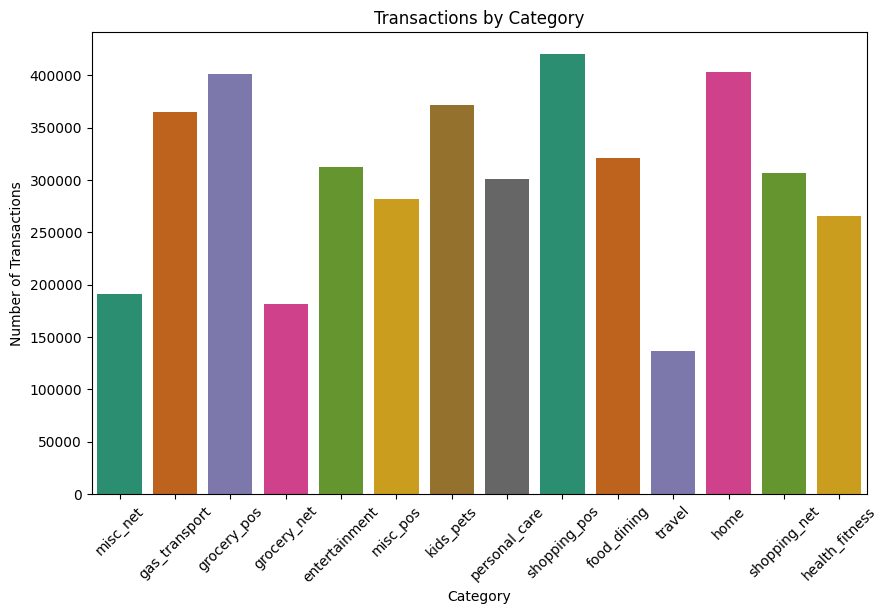

In [18]:
plt.figure(figsize=(10, 6))
sns.countplot(x=df.category, palette="Dark2")
plt.xticks(rotation=45)
plt.title('Transactions by Category')
plt.xlabel('Category')
plt.ylabel('Number of Transactions')
plt.show()

The category with the highest number of transactions is "shopping_pos," indicating that in-person shopping is the most frequent activity among customers.

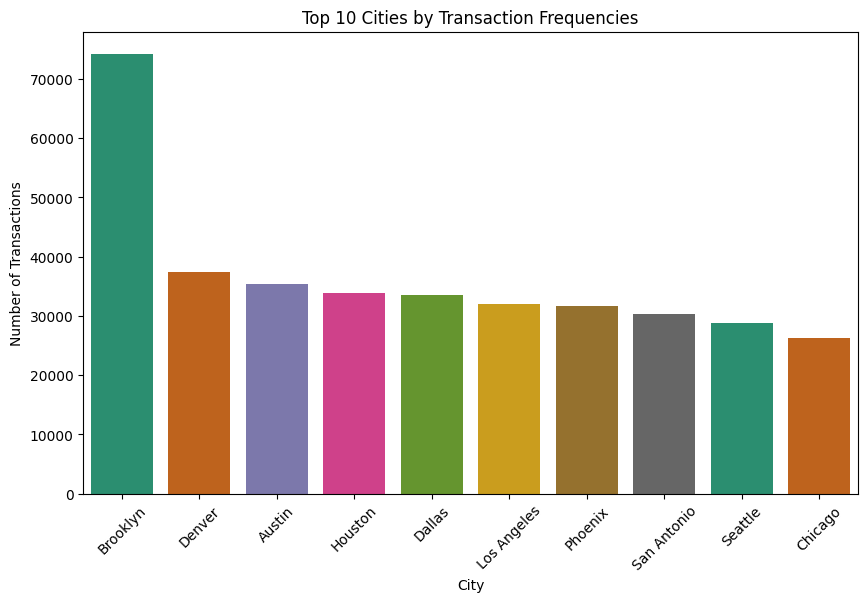

In [19]:
# Get the top 10 cities by transaction frequency
city_transaction_counts = df['city'].value_counts().head(10)

# Plot the data
plt.figure(figsize=(10, 6))
sns.barplot(x=city_transaction_counts.index, y=city_transaction_counts.values, palette="Dark2")
plt.title('Top 10 Cities by Transaction Frequencies')
plt.xlabel('City')
plt.ylabel('Number of Transactions')
plt.xticks(rotation=45)
plt.show()

Brooklyn leads in transaction frequencies by a significant margin compared to other cities, indicating higher customer activity there.

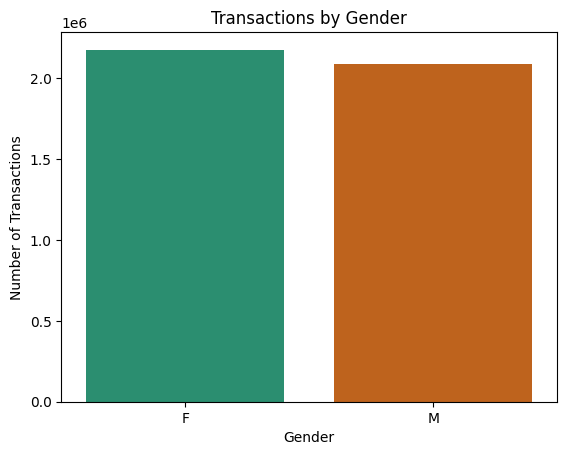

In [20]:
gender_counts = df['gender'].value_counts()
sns.barplot(x=gender_counts.index, y=gender_counts.values,  palette="Dark2")
plt.title('Transactions by Gender')
plt.xlabel('Gender')
plt.ylabel('Number of Transactions')
plt.show()

The number of transactions by females slightly exceeds that of males, indicating a higher transaction frequency among female customers.

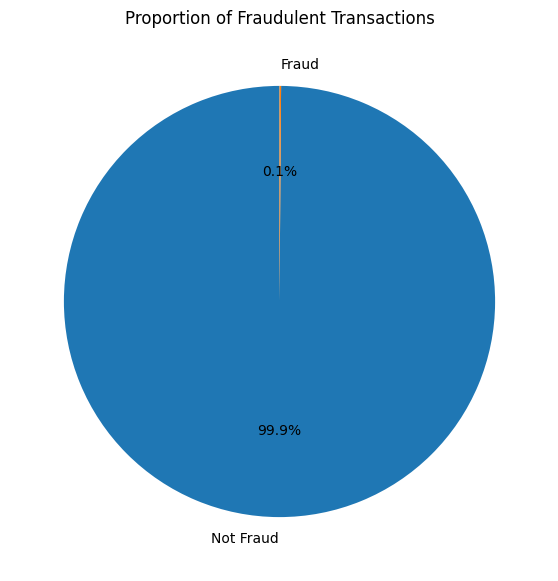

In [21]:
fraud_counts = df['is_fraud'].value_counts()
plt.figure(figsize=(7, 7))
plt.pie(fraud_counts, labels=['Not Fraud', 'Fraud'], autopct='%1.1f%%', startangle=90)
plt.title('Proportion of Fraudulent Transactions')
plt.show()

Fraudulent transactions constitute a very small fraction, just 0.1% of the total transactions, indicating a high level of transaction security indicating a highly imbalanced data

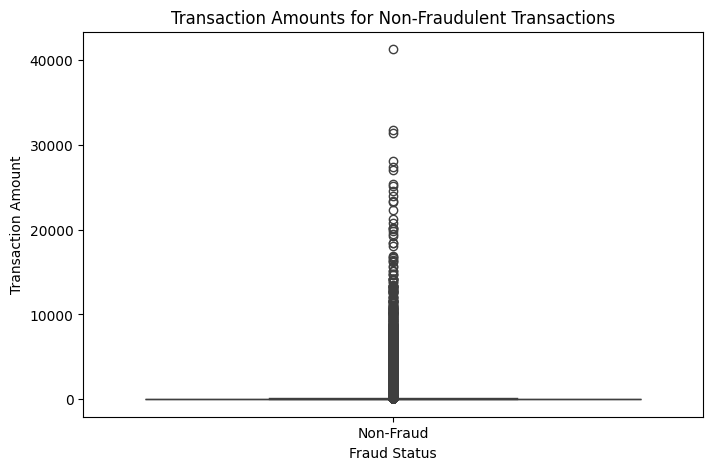

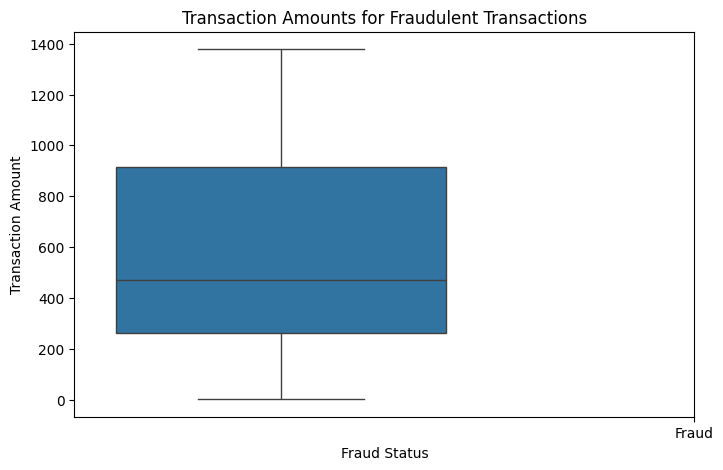

In [22]:
# Plot the box plot for non-fraudulent transactions
plt.figure(figsize=(8, 5))
sns.boxplot(x='is_fraud', y='amt', data=df[df['is_fraud'] == 0])
plt.title('Transaction Amounts for Non-Fraudulent Transactions')
plt.xlabel('Fraud Status')
plt.ylabel('Transaction Amount')
plt.xticks([0], ['Non-Fraud'])
plt.show()

# Plot the box plot for fraudulent transactions
plt.figure(figsize=(8, 5))
sns.boxplot(x='is_fraud', y='amt', data=df[df['is_fraud'] == 1])
plt.title('Transaction Amounts for Fraudulent Transactions')
plt.xlabel('Fraud Status')
plt.ylabel('Transaction Amount')
plt.xticks([1], ['Fraud'])
plt.show()

Non-fraudulent transactions vary widely in amount, with many high-value transactions, while fraudulent transactions are mostly between \$200 and $1,400.

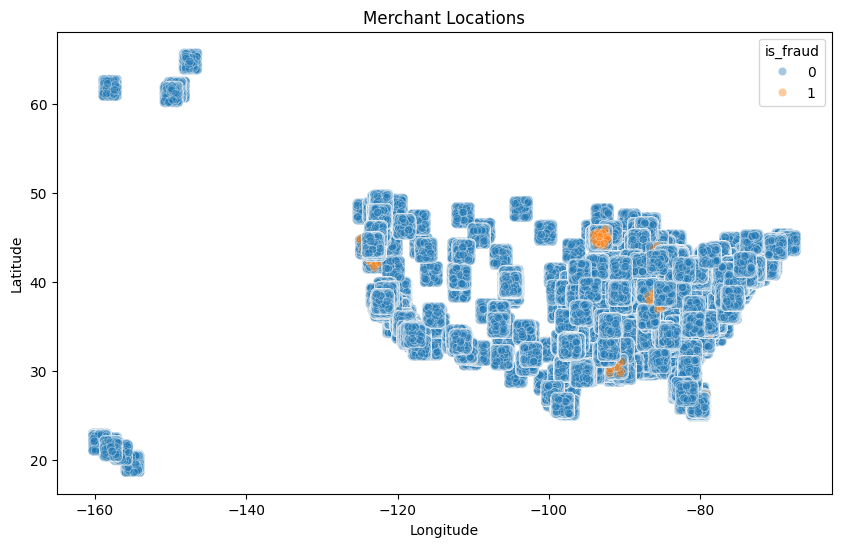

In [23]:
plt.figure(figsize=(10, 6))
sns.scatterplot(x='merch_long', y='merch_lat', hue='is_fraud', data=df, alpha=0.4)
plt.title('Merchant Locations')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.show()

The fraudulent transactions are dispersed throughout various merchant locations across the map of the United States.

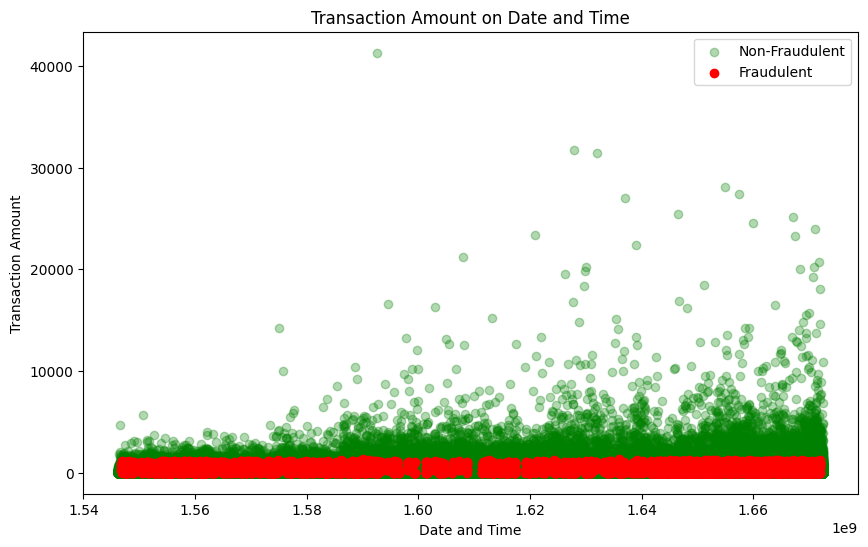

In [24]:
plt.figure(figsize=(10, 6))

# Plot non-fraudulent transactions
non_fraud = df[df['is_fraud'] == 0]
plt.scatter(non_fraud['unix_time'], non_fraud['amt'], color='green', alpha=0.3, label='Non-Fraudulent')

# Plot fraudulent transactions
fraud = df[df['is_fraud'] == 1]
plt.scatter(fraud['unix_time'], fraud['amt'], color='red', alpha=1.0, label='Fraudulent')
plt.title('Transaction Amount on Date and Time')
plt.xlabel('Date and Time')
plt.ylabel('Transaction Amount')
plt.legend()
plt.show()

Fraudulent transactions are consistently lower in amount compared to non-fraudulent transactions, which occasionally include very high-value amounts.

In [25]:
def calculate_age(df):
  x = pd.to_datetime(df['unix_time'], unit='s')
  y = pd.to_datetime(df['dob'])
  return x-y

In [26]:
# Convert unix_time to datetime if it's in Unix format
df['changed_unix_time'] = pd.to_datetime(df['unix_time'], unit='s')
df['dob'] = pd.to_datetime(df['dob'])

def calculate_age(row):
    return row['changed_unix_time'] - row['dob']

# Apply the function to calculate age
df['age'] = df.apply(calculate_age, axis=1)

# Convert the age from timedelta to years
df['age'] = df['age'].apply(lambda x: x.days // 365)

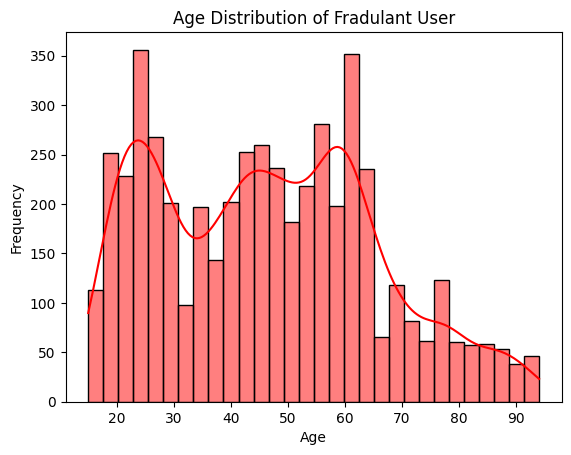

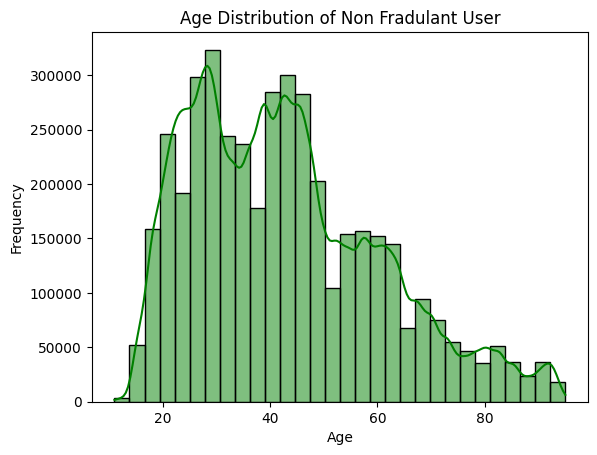

In [27]:
# Plot the age distribution of the cardholders
sns.histplot(df['age'][df['is_fraud']==1], bins=30, kde=True, color='red')
plt.title('Age Distribution of Fradulant User')
plt.xlabel('Age')
plt.ylabel('Frequency')
plt.show()

sns.histplot(df['age'][df['is_fraud']==0], bins=30, kde=True, color='green')
plt.title('Age Distribution of Non Fradulant User')
plt.xlabel('Age')
plt.ylabel('Frequency')
plt.show()

Fraudulent users are relatively evenly distributed across different age groups, whereas non-fraudulent users are predominantly concentrated in the 20-40 age range, with a significantly higher count overall.

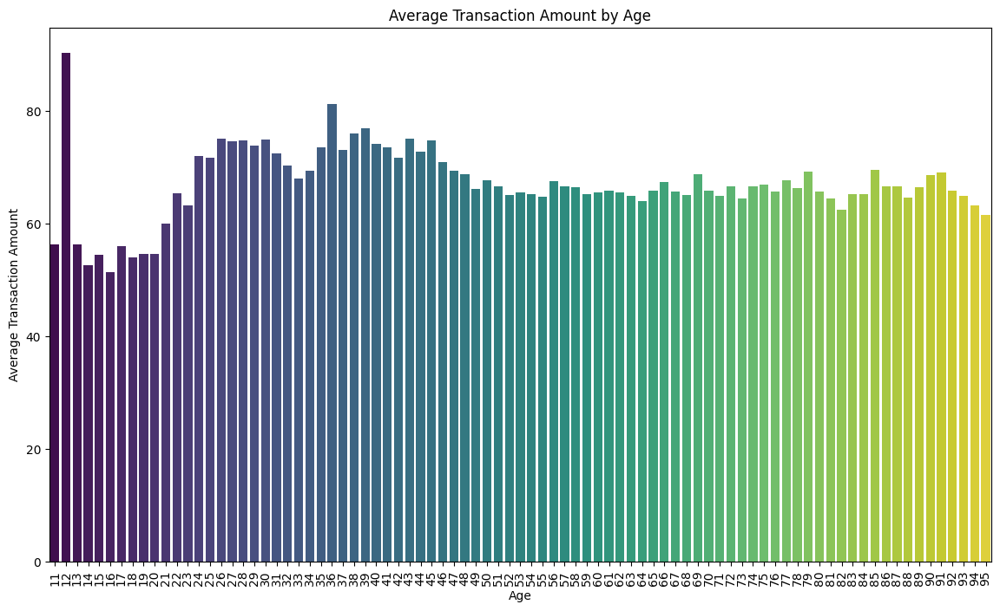

In [28]:
# Calculate the average transaction amount by age
age_amt_mean = df.groupby('age')['amt'].mean().reset_index()

# Plot the average transaction amount by age
plt.figure(figsize=(14, 8))
sns.barplot(x='age', y='amt', data=age_amt_mean, palette="viridis")
plt.title('Average Transaction Amount by Age')
plt.xlabel('Age')
plt.ylabel('Average Transaction Amount')
plt.xticks(rotation=90)  # Rotate x-axis labels if necessary
plt.show()

Average transaction amounts are relatively consistent across different ages, with some variability observed in the youngest and oldest age groups. Age 12 has the highest average transaction amount among all age groups.

In [29]:
# Funtion to calculate distance using longitude and latitude using earth circumference
def haversine(lat1, lon1, lat2, lon2):
    R = 6371  # Radius of the Earth in kilometers

    lat1_rad = np.radians(lat1)
    lon1_rad = np.radians(lon1)
    lat2_rad = np.radians(lat2)
    lon2_rad = np.radians(lon2)

    dlat = lat2_rad - lat1_rad
    dlon = lon2_rad - lon1_rad

    a = np.sin(dlat / 2) ** 2 + np.cos(lat1_rad) * np.cos(lat2_rad) * np.sin(dlon / 2) ** 2
    c = 2 * np.arcsin(np.sqrt(a))

    distance = R * c
    return distance

In [30]:
df['distance_km'] = df.apply(lambda row: haversine(row['lat'], row['long'], row['merch_lat'], row['merch_long']), axis=1)

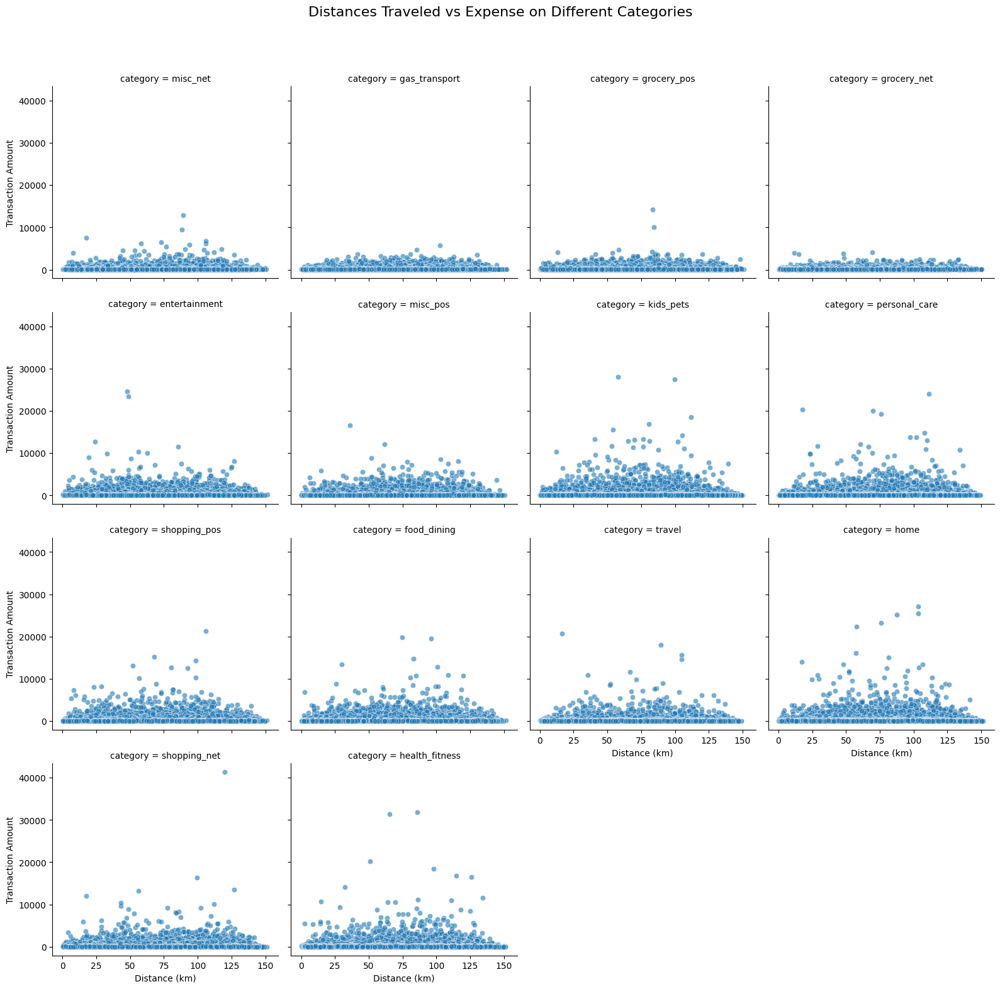

In [31]:
# Plotting distance vs expense on different categories
g = sns.FacetGrid(df, col="category", col_wrap=4, height=4, sharex=True, sharey=True)
g.map(sns.scatterplot, 'distance_km', 'amt', alpha=0.6)
g.fig.subplots_adjust(top=0.9)
g.fig.suptitle('Distances Traveled vs Expense on Different Categories', fontsize=16)
g.set_axis_labels('Distance (km)', 'Transaction Amount')
plt.show()

Most transaction amounts are low, with only a few high-value transactions in the travel, health, kids and pets, shopping POS, personal care, and home categories.

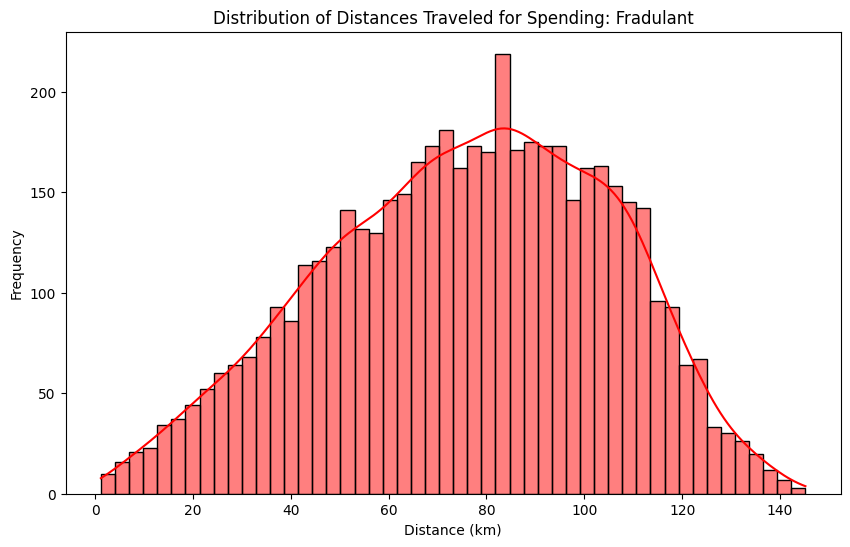

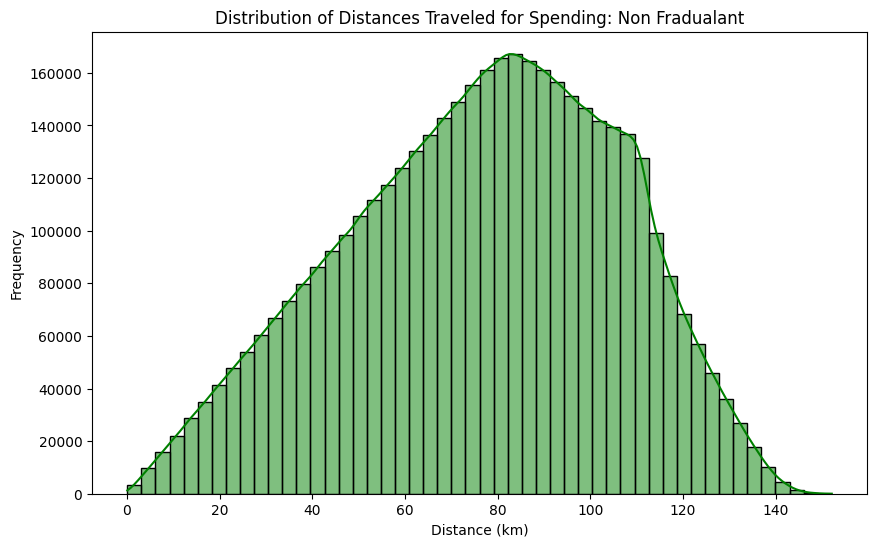

In [32]:
# Plot the distribution of distances traveled for fradulant
plt.figure(figsize=(10, 6))
sns.histplot(df[df['is_fraud']==1]['distance_km'], bins=50, kde=True, color='red')
plt.title('Distribution of Distances Traveled for Spending: Fradulant')
plt.xlabel('Distance (km)')
plt.ylabel('Frequency')
plt.show()

# Plot the distribution of distances traveled for non fradulant
plt.figure(figsize=(10, 6))
sns.histplot(df[df['is_fraud']==0]['distance_km'], bins=50, kde=True, color='green')
plt.title('Distribution of Distances Traveled for Spending: Non Fradualant')
plt.xlabel('Distance (km)')
plt.ylabel('Frequency')
plt.show()

Fraudulent transactions generally occur within 80-100 km of the customer's location, while non-fraudulent transactions show a more symmetric and smoother distribution, peaking around 80 km and gradually tapering off towards both shorter and longer distances

In [33]:
len(df.job.unique()) # number of unique jobs

505

In [34]:
txt = df['job'].to_string() # changing job words into a single string to create wordcloud

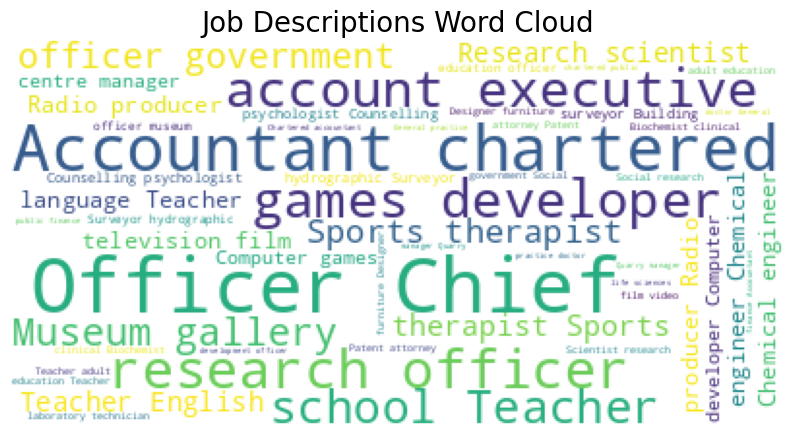

In [35]:
# Create the word cloud
plt.figure(figsize=(10, 8))
wordcloud = WordCloud(max_words=400, background_color='white').generate(txt)
plt.imshow(wordcloud)
plt.title("Job Descriptions Word Cloud", fontsize=20)
plt.axis("off")
plt.show()

From the wordcloud it can be seen that most people are officer, teacher, developer, acountant etc.

In [36]:
# define a mapping of job descriptions to broad categories
category_mapping = {
    'Teacher': ['teacher', 'tutor', 'educator', 'professor', 'instructor'],
    'Engineer': ['engineer', 'technician', 'architect', 'geologist', 'scientist'],
    'Manager': ['manager', 'administrator', 'director', 'supervisor'],
    'Medical Professional': ['doctor', 'nurse', 'therapist', 'pathologist', 'radiographer', 'psychologist', 'dentist', 'pharmacist', 'biochemist', 'cytogeneticist'],
    'Accountant': ['accountant', 'auditor', 'financial adviser', 'financial manager'],
    'Lawyer': ['solicitor', 'attorney', 'legal', 'barrister'],
    'Researcher': ['researcher', 'scientist'],
    'Sales': ['sales', 'account manager', 'sales executive'],
    'Media & Communications': ['editor', 'journalist', 'producer', 'broadcast', 'communications'],
    'IT Professional': ['software', 'developer', 'programmer', 'consultant', 'IT', 'data', 'analyst'],
    'Other': ['other']
}

# categorize job descriptions
def categorize_job(description):
    description = description.lower()
    for category, keywords in category_mapping.items():
        if any(keyword in description for keyword in keywords):
            return category
    return 'Other'

# improved function to handle overlaps
def improved_categorize_job(description):
    description = description.lower()
    category_scores = {category: 0 for category in category_mapping.keys()}

    for category, keywords in category_mapping.items():
        for keyword in keywords:
            if keyword in description:
                category_scores[category] += 1

    # Select category with the highest score
    best_category = max(category_scores, key=category_scores.get)
    return best_category

In [37]:
# Apply improved categorization function
df['job_desc'] = df['job'].apply(improved_categorize_job)

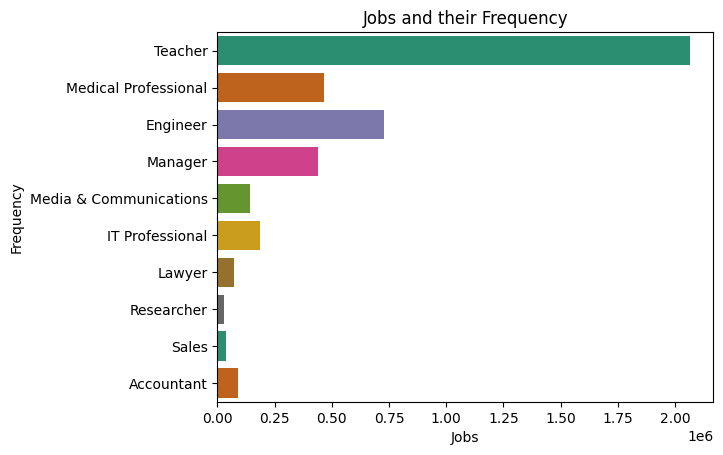

In [38]:
# barplot the new categorized jobs
sns.countplot(df['job_desc'],  palette="Dark2")
plt.title('Jobs and their Frequency')
plt.xlabel('Jobs')
plt.ylabel('Frequency')
plt.show()

After conversion, it is evident that teachers are the most dominant group among the customers.

In [39]:
df.job_desc.unique()

array(['Teacher', 'Medical Professional', 'Engineer', 'Manager',
       'Media & Communications', 'IT Professional', 'Lawyer',
       'Researcher', 'Sales', 'Accountant'], dtype=object)

### 4. Prepare Data

In [40]:
df_cleaned = df.copy()

In [41]:
# categorize the distance from customer to merchant
def categorize_distance(distance):
    if distance <= 30:
        return 'Very Short Distance'
    elif distance <= 60:
        return 'Short Distance'
    elif distance <= 90:
        return 'Moderate Distance'
    elif distance <= 120:
        return 'Long Distance'
    else:
        return 'Very Long Distance'

In [42]:
# apply categorization
df_cleaned['distance'] = df_cleaned['distance_km'].apply(categorize_distance)

In [43]:
# categorize the age
def categorize_age(age):
    if age <= 20:
        return '11-20'
    elif age <= 35:
        return '21-35'
    elif age <= 50:
        return '36-50'
    elif age <= 65:
        return '51-65'
    elif age <= 80:
        return '66-80'
    else:
        return '81+'

In [44]:
# Apply age categorization
df_cleaned['age_category'] = df_cleaned['age'].apply(categorize_age)

In [45]:
len(df_cleaned.category.unique())

14

In [46]:
# group by the specified columns and sum the 'amt' values
grouped_data = df_cleaned.groupby(['city', 'state', 'job_desc', 'age_category', 'distance', 'category', 'gender'])['amt'].sum().reset_index()

# pivot the table so that each category value becomes a column
pivot_table = grouped_data.pivot_table(index=['city', 'state', 'job_desc', 'age_category', 'distance', 'gender'],
                                       columns='category',
                                       values='amt',
                                       fill_value=0).reset_index()


The pivot table is created on the basis of features that generally affects spending behaviour which is grouped by fromm city, state, job, age, distance, category, and gender

In [47]:
data_cleaned = pivot_table.drop(['city', 'state', 'job_desc', 'age_category', 'distance', 'gender'], axis=1)

In [48]:
data_cleaned.head()

category,entertainment,food_dining,gas_transport,grocery_net,grocery_pos,health_fitness,home,kids_pets,misc_net,misc_pos,personal_care,shopping_net,shopping_pos,travel
0,10117.78,9411.51,9094.37,16056.04,22502.97,12319.57,18540.93,12379.49,13326.13,12910.52,9327.38,8984.54,18950.22,1829.46
1,13864.75,13866.55,8374.89,12967.38,30065.98,10203.07,15673.86,13777.83,11050.25,20290.53,13643.65,19698.60,19008.20,4025.47
2,5999.48,10654.46,6868.98,10126.65,17648.31,9197.97,10257.21,7398.97,7397.43,11629.76,9417.74,9756.31,11099.09,1736.53
3,1504.40,1225.15,1263.77,2353.88,3748.32,1993.22,2500.07,5140.84,1752.15,2646.95,1357.40,4217.13,2605.76,300.42
4,2467.92,3184.05,1526.71,3468.83,6881.51,1109.39,2470.35,3876.71,2172.44,3057.63,3407.12,4281.31,2955.76,556.57


In [49]:
data_cleaned.shape

(5988, 14)

The new data_cleaned dataframe includes expenses across different categories, categorized by city, state, job, age group, distance, and gender to identify shopping behavior.

In [50]:
# making a list of features to be considering
feat_list = data_cleaned.columns

In [51]:
feat_list

Index(['entertainment', 'food_dining', 'gas_transport', 'grocery_net',
       'grocery_pos', 'health_fitness', 'home', 'kids_pets', 'misc_net',
       'misc_pos', 'personal_care', 'shopping_net', 'shopping_pos', 'travel'],
      dtype='object', name='category')

In [52]:
data_cleaned.duplicated().sum() #checking duplicates

0

In [53]:

# defining and scaling
scaler = StandardScaler()
X = scaler.fit_transform(data_cleaned)

In [54]:
X

array([[ 1.70870146,  1.42804969,  1.06628325, ...,  1.15425695,
         2.48353389,  0.22411411],
       [ 2.66371184,  2.49884709,  0.9084339 , ...,  3.41912413,
         2.49366296,  1.44424643],
       [ 0.6590482 ,  1.72680068,  0.5780468 , ...,  1.317403  ,
         1.11194752,  0.17248096],
       ...,
       [-0.80367138, -0.77933067, -0.78899728, ..., -0.67483818,
        -0.80033124, -0.79235817],
       [-0.84670963, -0.80296732, -0.90764098, ..., -0.74420015,
        -0.80407854, -0.79235817],
       [-0.85165166, -0.78902425, -0.91516618, ..., -0.72554691,
        -0.77417876, -0.70100423]])

### 5. Train KMeans Model

In [ ]:
cluster_df = pd.DataFrame()
inertia_list = []

In [ ]:
# defining cluster number to calculate inertia
cluster_df['nb_cluster'] = range(1, 21)
cluster_df

,nb_cluster
0,1
1,2
2,3
3,4
4,5
5,6
6,7
7,8
8,9
9,10


In [ ]:
# calculates the inertia for value of k ranging from 1 to 20
for k in cluster_df['nb_cluster']:
    kmeans = KMeans(n_clusters=k, random_state=8).fit(X)
    inertia_list.append(kmeans.inertia_)

In [ ]:
# adding cluster to the dataframe
cluster_df['inertia'] = inertia_list

In [ ]:
cluster_df

,nb_cluster,inertia
0,1,83832.000000
1,2,39496.244605
2,3,26997.401799
3,4,22674.758027
4,5,20666.661264
5,6,19389.791296
6,7,18254.252732
7,8,17409.970917
8,9,16666.988555
9,10,15975.333686


The value of k is determined by the inertia by checking the elbow method from line plot.

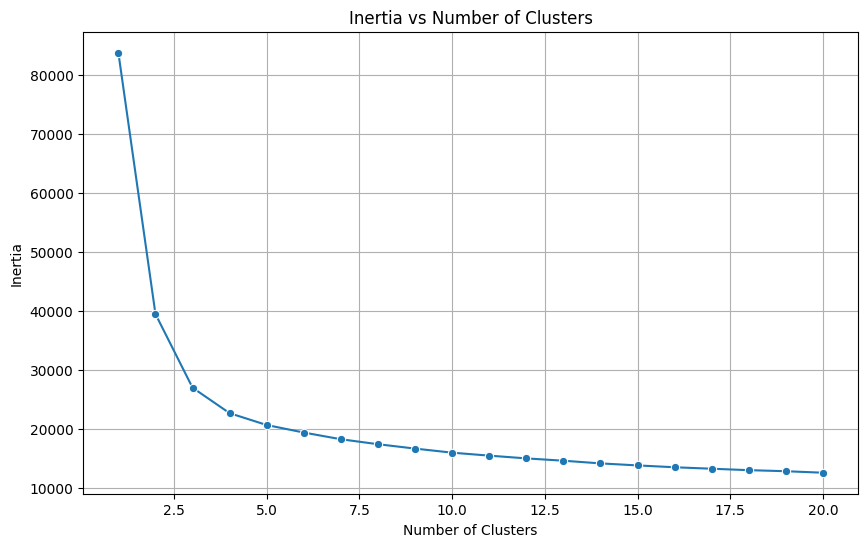

In [ ]:
# Plotting number of cluster vs inertia
plt.figure(figsize=(10, 6))
sns.lineplot(x='nb_cluster', y='inertia', data=cluster_df, marker='o')
plt.title('Inertia vs Number of Clusters')
plt.xlabel('Number of Clusters')
plt.ylabel('Inertia')
plt.grid(True)
plt.show()

From the above plot we can consider value 3

In [ ]:
k = 3

Checking the clustering with k = 4

In [ ]:
kmeans = KMeans(random_state=1, n_clusters=k)

In [ ]:
kmeans.fit(X)

KMeans(n_clusters=3, random_state=1)

In [ ]:
data_cleaned['kmeans'] = kmeans.predict(X)

In [55]:
# creating pairs to plot and show clustering
pairs = [(a, b) for idx, a in enumerate(feat_list) for b in feat_list[idx + 1:]]
pairs

[('entertainment', 'food_dining'),
 ('entertainment', 'gas_transport'),
 ('entertainment', 'grocery_net'),
 ('entertainment', 'grocery_pos'),
 ('entertainment', 'health_fitness'),
 ('entertainment', 'home'),
 ('entertainment', 'kids_pets'),
 ('entertainment', 'misc_net'),
 ('entertainment', 'misc_pos'),
 ('entertainment', 'personal_care'),
 ('entertainment', 'shopping_net'),
 ('entertainment', 'shopping_pos'),
 ('entertainment', 'travel'),
 ('food_dining', 'gas_transport'),
 ('food_dining', 'grocery_net'),
 ('food_dining', 'grocery_pos'),
 ('food_dining', 'health_fitness'),
 ('food_dining', 'home'),
 ('food_dining', 'kids_pets'),
 ('food_dining', 'misc_net'),
 ('food_dining', 'misc_pos'),
 ('food_dining', 'personal_care'),
 ('food_dining', 'shopping_net'),
 ('food_dining', 'shopping_pos'),
 ('food_dining', 'travel'),
 ('gas_transport', 'grocery_net'),
 ('gas_transport', 'grocery_pos'),
 ('gas_transport', 'health_fitness'),
 ('gas_transport', 'home'),
 ('gas_transport', 'kids_pets'),
 (

In [60]:
import matplotlib.pyplot as plt
import seaborn as sns

def clustering(data_cleaned, cluster_method, pairs):
    n_pairs = len(pairs)
    batch_size = 6
    n_cols = 2
    n_rows = batch_size // n_cols

    for batch_start in range(0, n_pairs, batch_size):
        batch_end = min(batch_start + batch_size, n_pairs)
        fig, axes = plt.subplots(n_rows, n_cols, figsize=(12, 6 * n_rows))
        current_pairs = pairs[batch_start:batch_end]

        for i, (a, b) in enumerate(current_pairs):
            row = i // n_cols
            col = i % n_cols
            ax = axes[row, col]
            sns.scatterplot(x=data_cleaned[a], y=data_cleaned[b], hue=data_cleaned[cluster_method], palette='viridis', alpha=0.5, ax=ax)
            ax.set_title(f'Scatter Plot: {a} vs {b}')

        # Hide any empty subplots
        for j in range(len(current_pairs), n_rows * n_cols):
            row = j // n_cols
            col = j % n_cols
            fig.delaxes(axes[row, col])

        plt.tight_layout()
        plt.show()

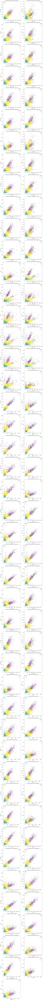

In [ ]:
clustering(data_cleaned, 'kmeans', pairs)

* There is a clear positive correlation between spending on entertainment and other categories such as food dining, gas transport, and grocery purchases, indicating that higher spenders in one category tend to spend more across multiple categories.
* The clustering reveals three distinct groups of customers: low spenders (cluster 1), moderate spenders (cluster 0), and high spenders (cluster 2), across all analyzed categories.
* The spending behavior for categories like health and fitness, personal care, and home expenses follows similar patterns, with high spenders on entertainment also showing higher expenditures in these categories.

In [ ]:
data_cleaned.groupby('kmeans').mean()

category,entertainment,food_dining,gas_transport,grocery_net,grocery_pos,health_fitness,home,kids_pets,misc_net,misc_pos,personal_care,shopping_net,shopping_pos,travel
kmeans,,,,,,,,,,,,,,
0,12394.151143,13664.347844,10536.313532,15796.051377,24913.595766,12407.003429,17767.449377,15703.867013,12970.398961,16879.625455,13707.817429,16957.142208,20098.849948,4510.231013
1,1324.322187,1291.156883,2237.483359,895.506614,2146.931442,990.452550,1587.372479,1575.277656,982.027376,1354.493524,1297.140488,1303.592607,1797.951881,625.268950
2,6733.758951,6723.280892,7982.720597,3698.009285,8922.496459,5313.445325,8130.340734,7265.401226,4181.764977,6101.157620,5644.542256,6071.344052,8706.934256,2788.970656


In [ ]:
labels = kmeans.labels_
silhouette_avg = silhouette_score(X, labels)
silhouette_avg

0.5043144313602247

A silhouette score of 0.5043 for the K-means clustering indicates a moderately good clustering quality. This score suggests that the clusters are reasonably well-separated, with most points being closer to their own cluster center than to other cluster centers. However, there is still some overlap between clusters, indicating room for improvement in cluster separation.

### 6. Train MeanShift Model

In [56]:
meanshift = MeanShift()

In [57]:
meanshift.fit(X) # Fitting model

MeanShift()

In [58]:
data_cleaned['meanshift'] = meanshift.predict(X)

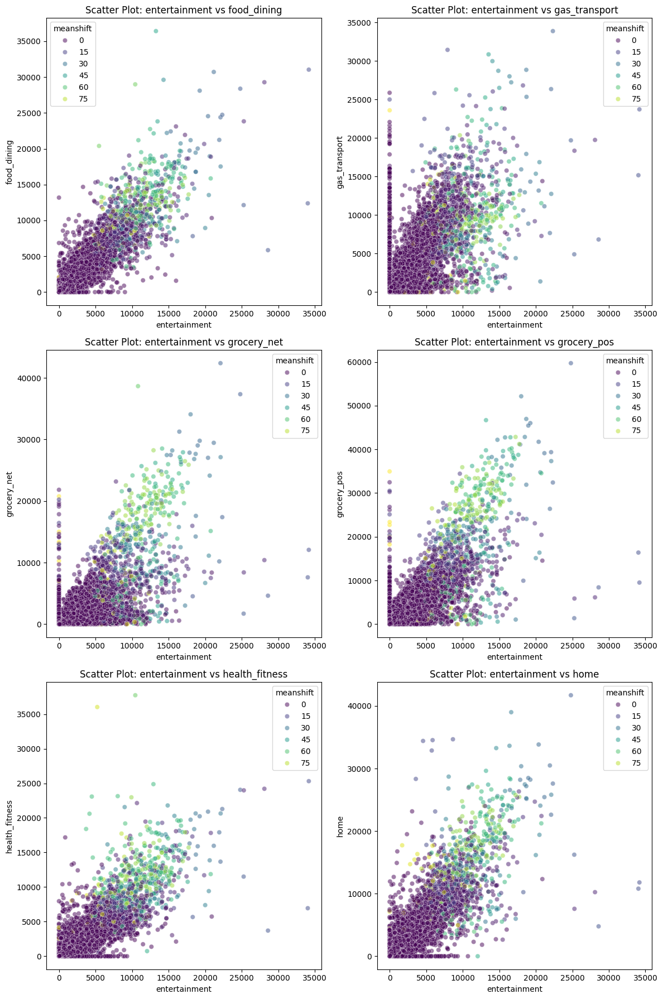

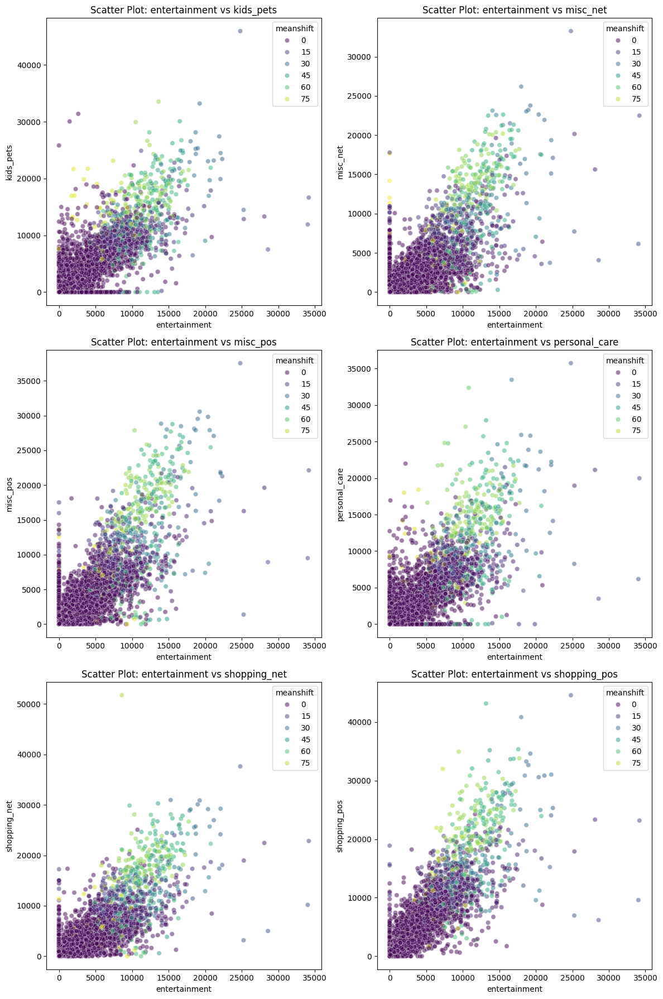

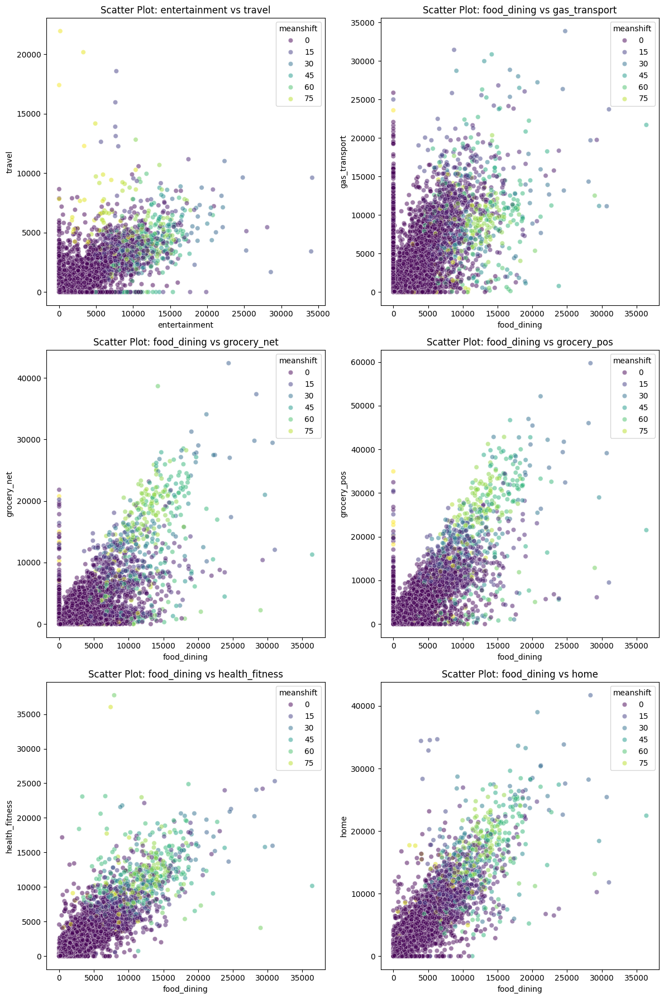

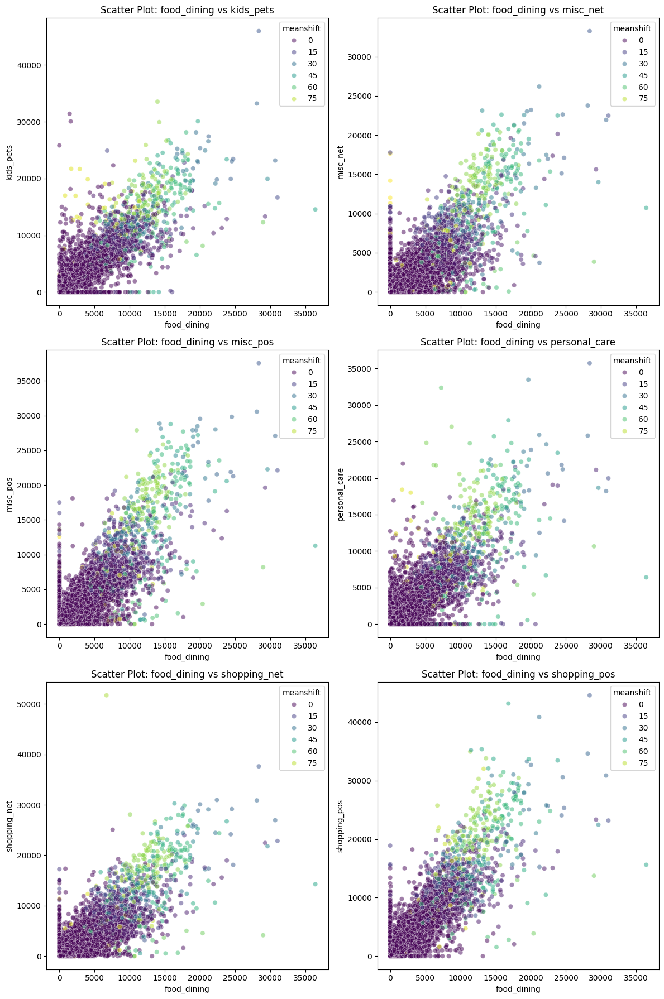

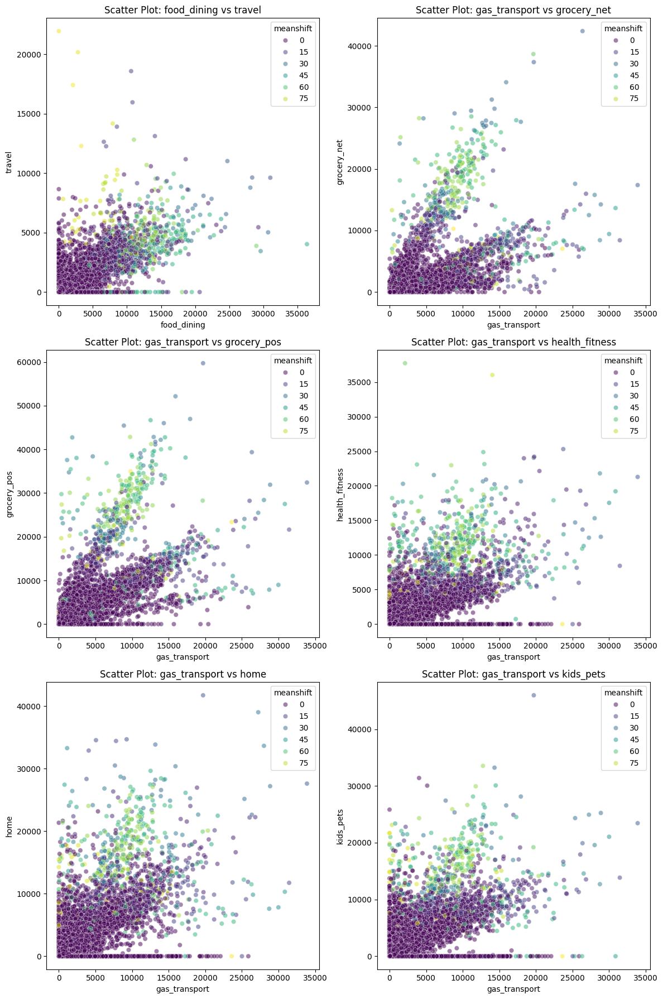

...

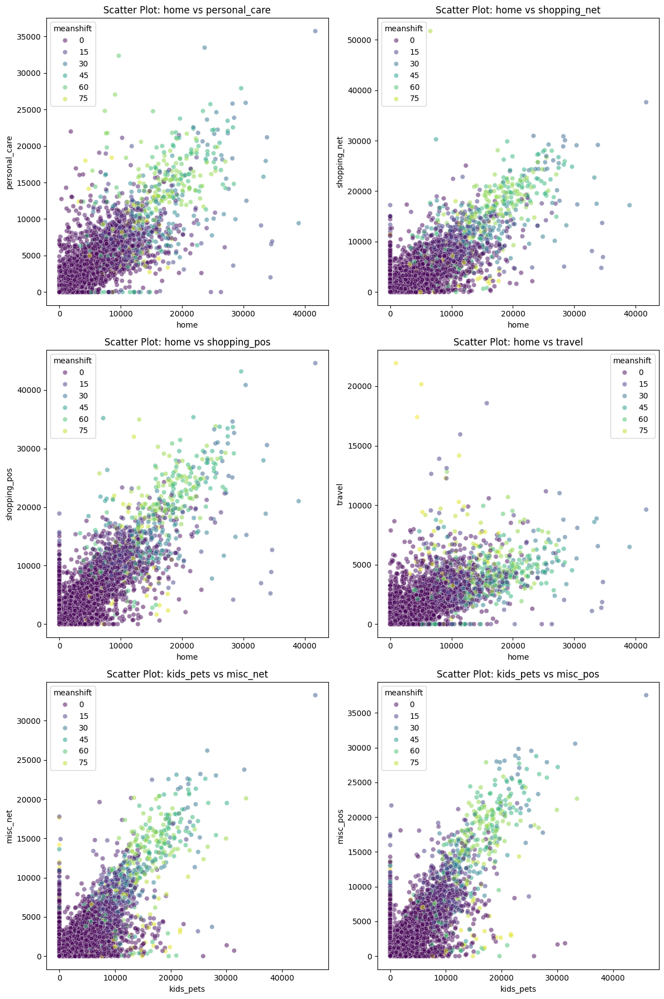

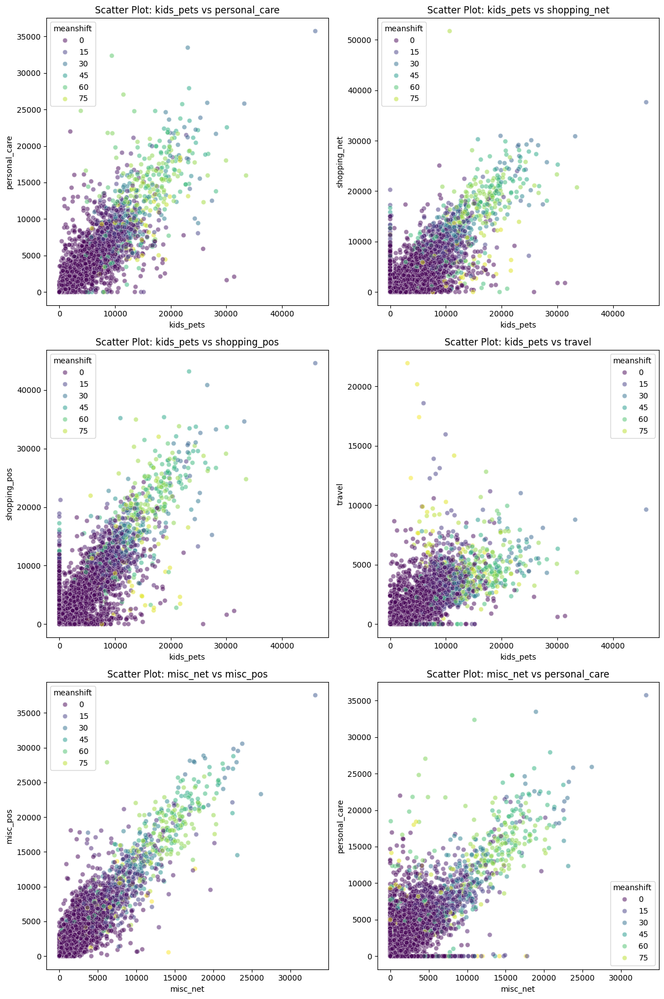

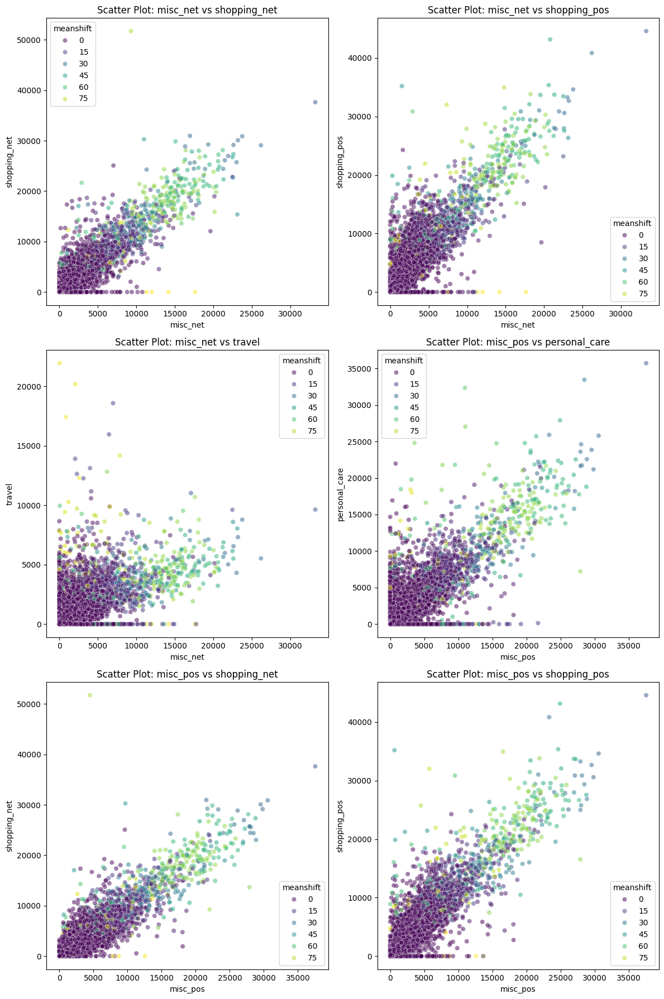

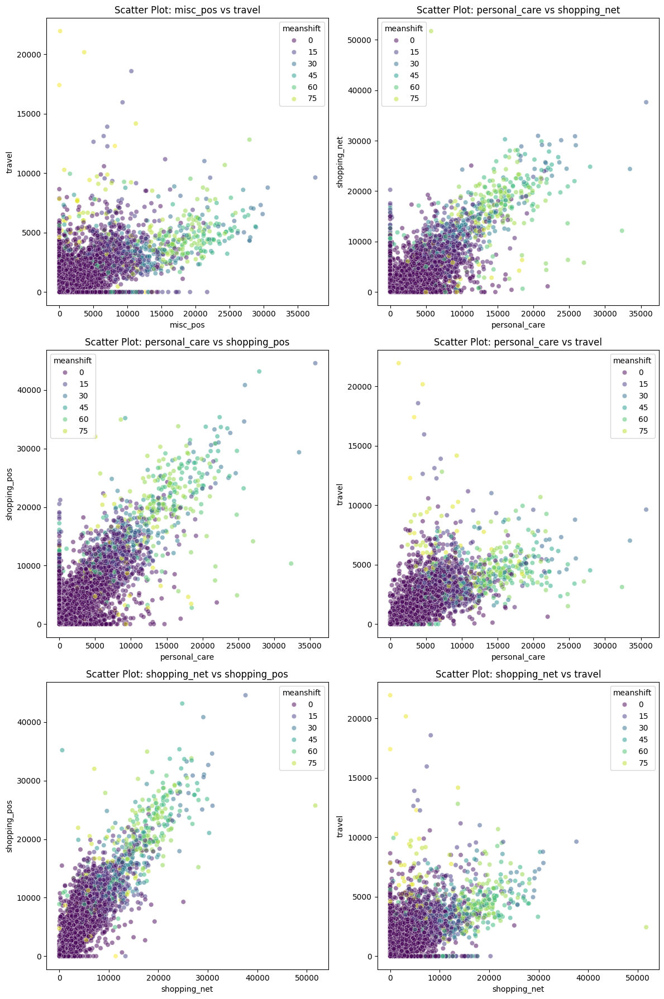

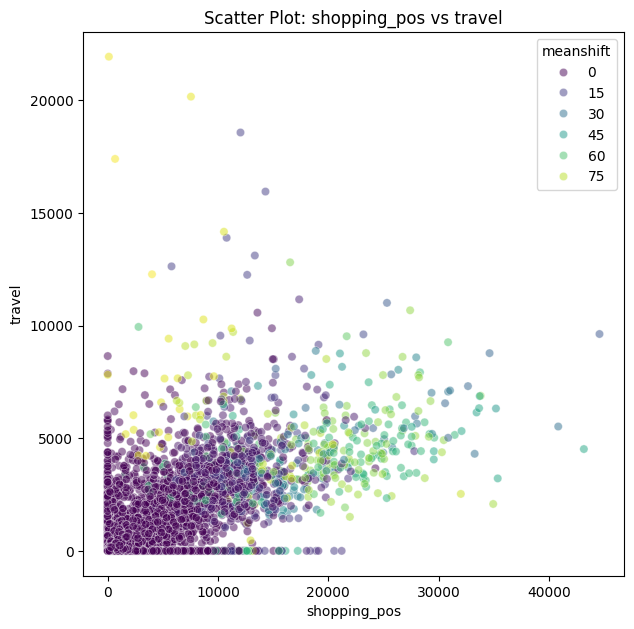

In [61]:
# Clustering meanshift
clustering(data_cleaned, 'meanshift', pairs)

The Mean Shift clustering algorithm produced 75 labels, with a dominant presence of cluster 0, indicating it failed to identify distinct, well-separated groups. This suggests Mean Shift might not be the optimal clustering method for this dataset.

In [ ]:
labels_ms = meanshift.labels_
silhouette_ms = silhouette_score(X, labels_ms)
silhouette_ms

A silhouette score of 0.3834 for the Mean Shift clustering indicates a lower clustering quality compared to the K-means clustering. This score suggests that the clusters are not well-separated, with significant overlap between them. The high number of labels (75) and the dominance of cluster 0 further confirm that Mean Shift clustering has not effectively captured distinct groups with similar spending behaviour in the data.

### 7. Train AgglomerativeClustering Model

In [ ]:
model = AgglomerativeClustering(distance_threshold=0, n_clusters=None)

In [ ]:
model.fit(X) # Fitting affglomerative model

AgglomerativeClustering(distance_threshold=0, n_clusters=None)

In [ ]:
# Function for Plotting dendrogram
def plot_dendrogram(model, **kwargs):
    counts = np.zeros(model.children_.shape[0])
    n_samples = len(model.labels_)
    for i, merge in enumerate(model.children_):
        current_count = 0
        for child_idx in merge:
            if child_idx < n_samples:
                current_count += 1  # leaf node
            else:
                current_count += counts[child_idx - n_samples]
        counts[i] = current_count

    linkage_matrix = np.column_stack(
        [model.children_, model.distances_, counts]
    ).astype(float)

    plt.figure(figsize=(20, 8))
    dendrogram(linkage_matrix, **kwargs)

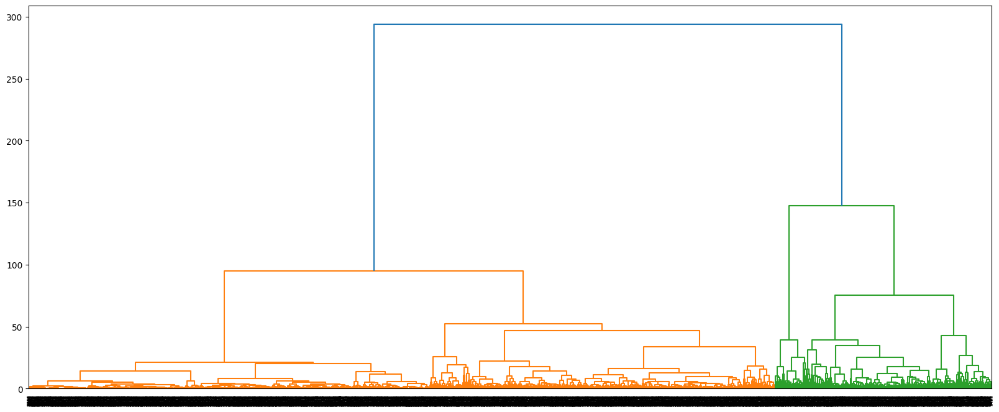

In [ ]:
plot_dendrogram(model)

The dendrogram suggests considering 3 clusters for hierarchical clustering, as there are clear large separations at these levels, indicating distinct groups in the data.

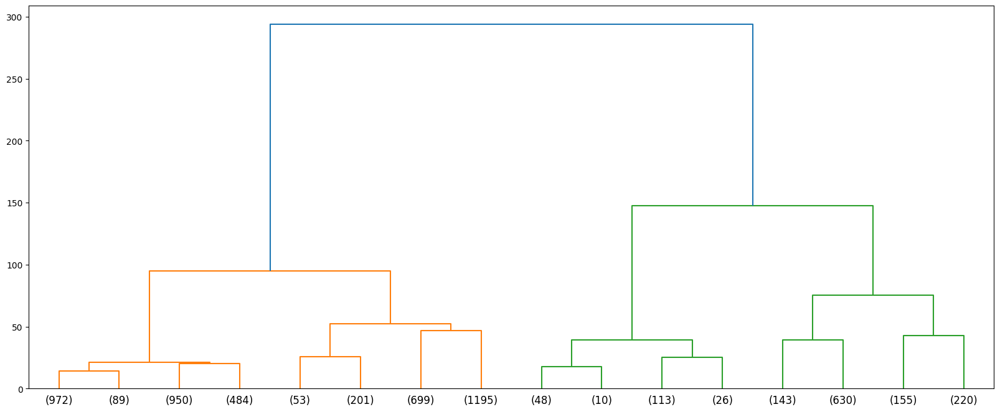

In [ ]:
plot_dendrogram(model, truncate_mode="level", p=3)

In [ ]:
ac3 = AgglomerativeClustering(n_clusters = 3)

In [ ]:
data_cleaned['aggcluster3'] = ac3.fit_predict(X)

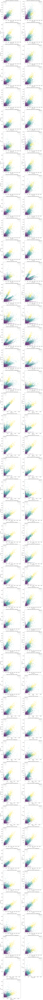

In [ ]:
clustering(data_cleaned, 'aggcluster3', pairs)

In [ ]:
labels_agg = ac3.labels_
silhouette_agg = silhouette_score(X, labels_agg)
silhouette_agg

0.5448643286389451

The agglomerative clustering model, with a silhouette score of 0.5448, effectively distinguishes between low, medium, and high spenders, showing clear separation among clusters and capturing diverse spending behaviors across multiple categories.

### 8. Train Model using decomposition PCA

In [ ]:
pca = PCA()

In [ ]:
pca.fit(X)

PCA()

In [ ]:
# Generate a list of principal component labels
pc_list = [f'PC{i}' for i in list(range(1, pca.n_features_ + 1))]
pc_list

['PC1',
 'PC2',
 'PC3',
 'PC4',
 'PC5',
 'PC6',
 'PC7',
 'PC8',
 'PC9',
 'PC10',
 'PC11',
 'PC12',
 'PC13',
 'PC14']

In [ ]:
pc_data = {
    'pc': pc_list,
    'exp_variance': list(pca.explained_variance_ratio_)
}
pc_df = pd.DataFrame(pc_data)
pc_df

In [ ]:
pc_df['cuml_var'] = pc_df['exp_variance'].cumsum()
pc_df

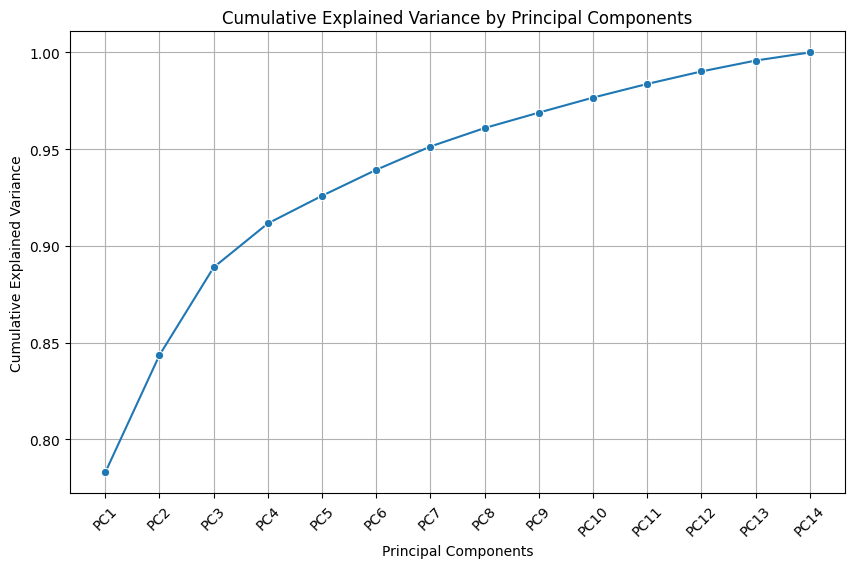

In [ ]:
plt.figure(figsize=(10, 6))
sns.lineplot(data=pc_df, x='pc', y='cuml_var', marker='o')
plt.title('Cumulative Explained Variance by Principal Components')
plt.xlabel('Principal Components')
plt.ylabel('Cumulative Explained Variance')
plt.xticks(rotation=45)
plt.grid(True)
plt.show()

Based on the plot, the first four principal components together explain approximately 90% of the variance in the data. This suggests that using these four components would provide a good balance between dimensionality reduction and information retention, capturing most of the data's variability while simplifying the dataset significantly.

In [ ]:
pc_loadings = dict(zip(pc_list, pca.components_))
loadings_df = pd.DataFrame(pc_loadings)
loadings_df.insert(0,'feature_names', feat_list)
loadings_df

,feature_names,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10,PC11,PC12,PC13,PC14
0,entertainment,0.272059,0.176094,0.189766,-0.383295,-0.134235,-0.380471,-0.132810,-0.240272,-0.041198,0.680216,0.066970,-0.048669,-0.048405,0.017747
1,food_dining,0.277309,0.172489,0.097782,-0.322378,-0.114610,-0.112722,-0.128260,-0.433100,0.397896,-0.616789,0.071985,-0.023233,-0.030590,0.067687
2,gas_transport,0.203382,-0.131522,0.888672,0.146331,0.260268,0.173517,0.126742,0.032062,-0.028456,-0.030623,0.062872,0.064330,-0.013024,-0.072387
3,grocery_net,0.258022,-0.427676,-0.207128,0.237422,-0.145303,0.231257,-0.032420,-0.344356,0.250487,0.204357,0.216334,0.415923,-0.008081,-0.364224
4,grocery_pos,0.278276,-0.299705,-0.043448,0.176001,0.022400,0.092540,-0.297354,-0.101679,-0.095142,0.041647,-0.316473,0.093393,-0.153064,0.740918
5,health_fitness,0.272847,0.119022,-0.021123,-0.303522,-0.453609,0.477286,0.536141,0.109133,-0.109850,0.029214,-0.244924,0.051151,-0.084760,0.056456
6,home,0.277932,0.150551,-0.075004,-0.130929,0.010575,0.432532,-0.532148,0.094569,-0.464201,-0.088657,0.340772,-0.149048,0.135489,-0.134009
7,kids_pets,0.272534,0.248796,-0.148797,-0.069974,0.430311,0.243228,-0.101415,0.383689,0.611618,0.213459,-0.115475,-0.033142,0.029680,0.002267
8,misc_net,0.277167,-0.302342,-0.056305,0.134209,-0.065512,-0.089227,0.174618,-0.059568,0.066051,0.021133,-0.066715,-0.601860,0.626731,-0.002414
9,misc_pos,0.284113,-0.208502,-0.066223,0.064468,0.008995,-0.183055,-0.092322,0.128601,-0.089485,-0.111169,-0.314659,-0.369029,-0.609502,-0.426101


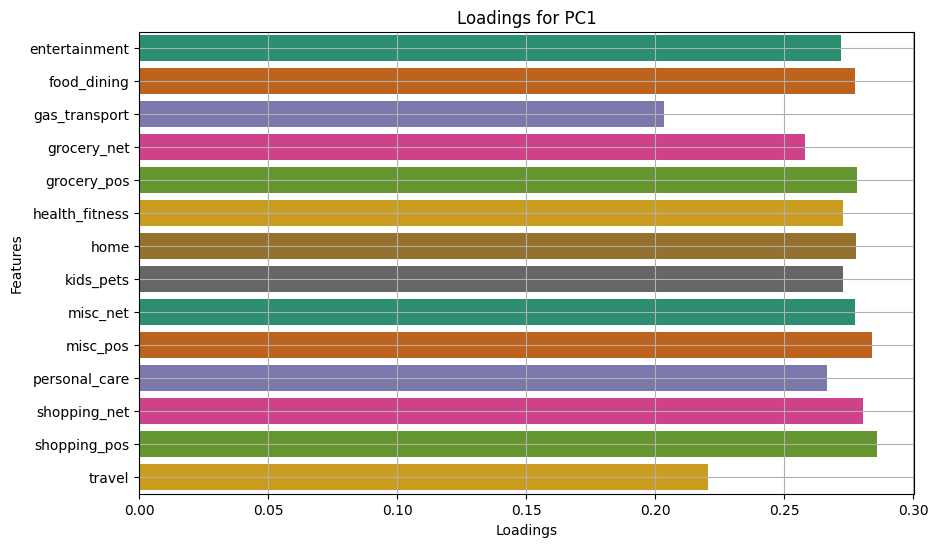

In [ ]:
# Plotting Loadings of PC1
plt.figure(figsize=(10, 6))
sns.barplot(data=loadings_df, x='PC1', y='feature_names', palette='Dark2')
plt.title('Loadings for PC1')
plt.xlabel('Loadings')
plt.ylabel('Features')
plt.grid(True)
plt.show()

The loadings for PC1 suggest that all features contribute significantly and relatively evenly to the first principal component, indicating that PC1 captures a broad spectrum of the data's variance across multiple features.

In [ ]:
# Plotting Loadings of PC2
plt.figure(figsize=(10, 6))
sns.barplot(data=loadings_df, x='PC2', y='feature_names', palette='viridis')
plt.title('Loadings for PC2')
plt.xlabel('Loadings')
plt.ylabel('Features')
plt.grid(True)
plt.show()

The loadings for PC2 suggest that the "travel" feature has the most significant positive contribution, while "entertainment" and "food_dining" have substantial negative contributions, indicating that PC2 captures variance primarily related to differences between these specific categories.

In [ ]:
# Plotting Loadings of PC3
plt.figure(figsize=(10, 6))
sns.barplot(data=loadings_df, x='PC3', y='feature_names', palette='viridis')
plt.title('Loadings for PC3')
plt.xlabel('Loadings')
plt.ylabel('Features')
plt.grid(True)
plt.show()

The loadings for PC3 indicate that "gas_transport" has the highest positive contribution, while "personal_care" has a notable negative contribution. This suggests that PC3 captures variance primarily related to differences in spending on gas transport and personal care.

In [ ]:
# Plotting Loadings of PC4
plt.figure(figsize=(10, 6))
sns.barplot(data=loadings_df, x='PC4', y='feature_names', palette='viridis')
plt.title('Loadings for PC4')
plt.xlabel('Loadings')
plt.ylabel('Features')
plt.grid(True)
plt.show()

The loadings for PC4 show that "travel" has the highest positive contribution, while "entertainment" and "food_dining" have substantial negative contributions. This indicates that PC4 captures variance primarily related to differences in spending on travel versus entertainment and food dining.

In [ ]:
pca = PCA(4).fit(X)

In [ ]:
pca_df = pd.DataFrame(pca.transform(X))

In [ ]:
pca_df.columns = ['PC1', 'PC2', 'PC3', 'PC4']
pca_df

In [ ]:
cluster_df = pd.DataFrame()
inertia_list = []

In [ ]:
cluster_df['nb_cluster'] = range(1, 20)

In [ ]:
for k in cluster_df['nb_cluster']:
    kmeans = KMeans(n_clusters=k, random_state=8, n_init=10).fit(pca_df)
    inertia_list.append(kmeans.inertia_)

In [ ]:
cluster_df['inertia'] = inertia_list

In [ ]:
# Plotting inertia and number of clusters
plt.figure(figsize=(10, 6))
sns.lineplot(x='nb_cluster', y='inertia', data=cluster_df, marker='o')
plt.title('Inertia vs Number of Clusters')
plt.xlabel('Number of Clusters')
plt.ylabel('Inertia')
plt.grid(True)
plt.show()

The elbow plot suggests that 3 clusters is the optimal choice, as the inertia significantly decreases and begins to level off around the point.

In [ ]:
k=3

In [ ]:
kmeans = KMeans(random_state=1, n_clusters=k)

In [ ]:
kmeans.fit(pca_df)

In [ ]:
#predict and make a column label for kmeans_pca
pca_df['kmeans_pca'] = kmeans.predict(pca_df)

In [ ]:
pca_list = ['PC1', 'PC2', 'PC3', 'PC4']
pairs = [(a, b) for idx, a in enumerate(pca_list) for b in pca_list[idx + 1:]]
pairs

In [ ]:
# clustering PCA transformed KMeans
clustering(pca_df, 'kmeans_pca', pairs)

The PCA and KMeans clustering analysis revealed three key customer segments: general spenders, travel and POS shoppers, and affluent or broad spenders. PC1 captures general spending behavior across categories, PC2 highlights differences in travel and POS shopping, PC3 focuses on transport spending, and PC4 is influenced by travel expenses and inversely related to entertainment and dining. Cluster 0 shows balanced spending across various categories, Cluster 1 has conservative spending habits with low transport and travel expenses, and Cluster 2 spends significantly on travel and has varied transport expenses. Based on these insights, marketing strategies include offering bundle deals and loyalty programs for general spenders, exclusive travel deals and POS discounts for travel shoppers, and premium services and personalized ads for high spenders, enhancing customer engagement.

In [ ]:
# Calculating silhouette score
labels_pca = kmeans.labels_
silhouette_pca = silhouette_score(pca_df, labels)
silhouette_pca

A silhouette score of 0.5679 for the PCA-transformed data indicates a good clustering quality. This score suggests that the clusters are well-separated.

### 9. Assess Model Performance

In [ ]:
# Display Top 20 data
data_cleaned.head(20)

In [ ]:
print(f'Silhouette Score: \n \
  KMeans : {silhouette_avg} \n \
  MeanShift: {silhouette_ms} \n \
  Agglomerative Clustering: {silhouette_agg} \n \
  KMeans PCA: {silhouette_pca}')

The PCA-transformed KMeans clustering achieved the best performance with a silhouette score of 0.5679, indicating excellent cluster separation. MeanShift performed the worst, with a score of 0.3835, while Agglomerative Clustering and standard KMeans had moderate scores of 0.5449 and 0.5043, respectively.
<br><br>
Key findings suggest that PCA significantly improves clustering quality, and MeanShift is not effective for this dataset. Future recommendations include exploring other algorithms like DBSCAN or Gaussian Mixture Models, and fine-tuning hyperparameters to enhance clustering results.